# Creating plots and maps for analysis and geospatial visualization

The code for this was taken and adapted from the MAST30034 - Applied Data Science tutorial notebooks

The code was also debugged using ChatGPT and was used in editing the visualizations for a better look

In [1]:
# Import required packages
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt 
import geopandas as gpd
import folium
import numpy as np 

In [2]:
# Load the CSV files
borough_data = pd.read_csv('../data/curated/events/event_per_borough.csv')
precinct_data = pd.read_csv('../data/curated/events/event_per_precinct.csv')

In [3]:
precinct_data.head()

,police_precinct,total_event_count
0,1,1148
1,5,6378
2,6,4185
3,7,4519
4,9,4328


In [4]:
borough_data

,event_borough,total_event_count
0,Bronx,35429
1,Brooklyn,64373
2,Manhattan,86497
3,Queens,55629
4,Staten Island,13243


## Create the geoJSON for Police precincts

In [5]:
# read in the precincts shapefile
sf = gpd.read_file("../data/raw/precincts/nypp.shp")
zones = pd.read_csv("../data/raw/precincts/nypp.csv")

sf.head()

,Precinct,Shape_Leng,Shape_Area,geometry
0,1,80093.534429,4.728501e+07,"MULTIPOLYGON (((972081.788 190733.467, 972184...."
1,5,18807.124911,1.809453e+07,"POLYGON ((987399.207 202660.992, 987385.83 202..."
2,6,27255.991120,2.214302e+07,"POLYGON ((981714.03 209792.184, 981770.123 209..."
3,7,17287.544493,1.836667e+07,"POLYGON ((991608.135 201215.298, 991575.973 20..."
4,9,19772.510741,2.139539e+07,"POLYGON ((992119.124 204042.761, 992114.154 20..."


In [6]:
# Convert the geometry shape to to latitude and longitude
# Please attribute this if you are using it
sf['geometry'] = sf['geometry'].to_crs("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")
sf.head()

,Precinct,Shape_Leng,Shape_Area,geometry
0,1,80093.534429,4.728501e+07,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ..."
1,5,18807.124911,1.809453e+07,"POLYGON ((-73.98864 40.72293, -73.98869 40.722..."
2,6,27255.991120,2.214302e+07,"POLYGON ((-74.00915 40.74251, -74.00895 40.742..."
3,7,17287.544493,1.836667e+07,"POLYGON ((-73.97346 40.71896, -73.97357 40.718..."
4,9,19772.510741,2.139539e+07,"POLYGON ((-73.97161 40.72672, -73.97163 40.726..."


In [7]:
zones.head()

,OBJECTID,Precinct,Shape__Area,Shape__Length
0,1,1,4.728501e+07,80093.534427
1,2,5,1.809453e+07,18807.124911
2,3,6,2.214302e+07,27255.991120
3,4,7,1.836667e+07,17287.544493
4,5,9,2.139539e+07,19772.510741


In [8]:
gdf = gpd.GeoDataFrame(
    pd.merge(zones, sf, on='Precinct', how='inner')
)

gdf.head()

,OBJECTID,Precinct,Shape__Area,Shape__Length,Shape_Leng,Shape_Area,geometry
0,1,1,4.728501e+07,80093.534427,80093.534429,4.728501e+07,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ..."
1,2,5,1.809453e+07,18807.124911,18807.124911,1.809453e+07,"POLYGON ((-73.98864 40.72293, -73.98869 40.722..."
2,3,6,2.214302e+07,27255.991120,27255.991120,2.214302e+07,"POLYGON ((-74.00915 40.74251, -74.00895 40.742..."
3,4,7,1.836667e+07,17287.544493,17287.544493,1.836667e+07,"POLYGON ((-73.97346 40.71896, -73.97357 40.718..."
4,5,9,2.139539e+07,19772.510741,19772.510741,2.139539e+07,"POLYGON ((-73.97161 40.72672, -73.97163 40.726..."


In [9]:
# create a JSON 
geoJSON_precincts = gdf[['Precinct', 'geometry']].drop_duplicates('Precinct').to_json()

## Testing the precinct shapefile

In [10]:
_map = folium.Map(location=[40.66, -73.94], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on how to plot aggregated data.
_map.add_child(folium.Choropleth(
    geo_data=geoJSON_precincts,
    name='choropleth',
))

_map.save('../plots/foliumChoroplethMap.html')
_map

## Map the total number of events per precinct

In [11]:
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
c = folium.Choropleth(
    geo_data=geoJSON_precincts, # geoJSON 
    name='choropleth', # name of plot
    data=precinct_data.reset_index(), # data source
    columns=['police_precinct','total_event_count'], # the columns required
    key_on='properties.Precinct', # this is from the geoJSON's properties
    fill_color='YlGnBu', # color scheme
    nan_fill_color='black',
    legend_name='Number of Events'
)

c.add_to(m)

m

In [12]:
m.save('../plots/EventsPerPrecinctMap.html')

### Distribution of events across the boroughs

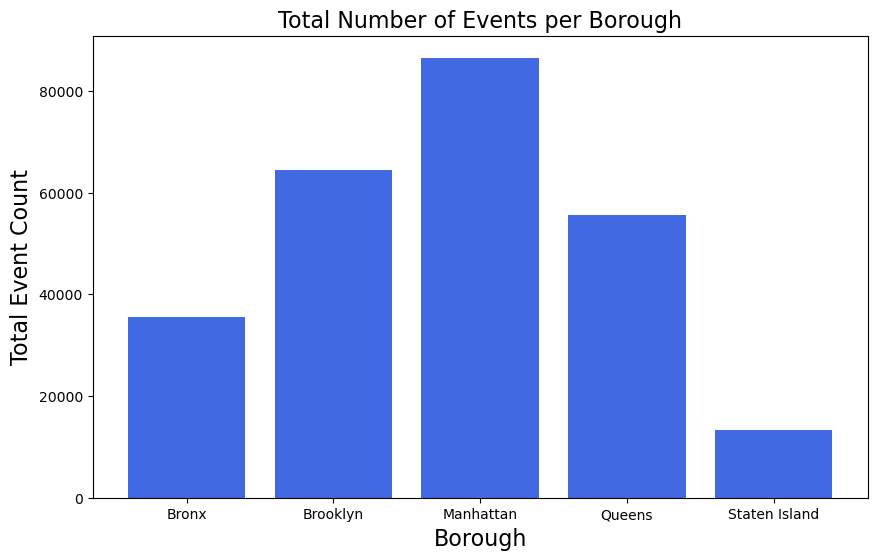

In [13]:
# Plotting the histogram
plt.figure(figsize=(10, 6))
plt.bar(borough_data['event_borough'], borough_data['total_event_count'], color='royalblue')

# Adding title and labels
plt.title('Total Number of Events per Borough', fontsize=16)
plt.xlabel('Borough', fontsize=16)
plt.ylabel('Total Event Count', fontsize=16)

# Save the plot as a PNG file
plt.savefig('../plots/total_events_per_borough.png', dpi=300, bbox_inches='tight')

# Display the plot
plt.show()

In [14]:
pu_do_counts = pd.read_csv("../data/curated/taxi/pu_do_counts_location.csv")

In [15]:
pu_do_counts.head()

,location_id,total_pickup_count,total_dropoff_count
0,2,25,6
1,3,124,386
2,4,72576,269210
3,5,0,4
4,6,83,95


## Create the geoJSON for taxi zones

In [16]:
# read in the taxi zone shape files
sf = gpd.read_file("../data/raw/taxi_zones/taxi_zones.shp")
zones = pd.read_csv("../data/raw/taxi_zones/taxi+_zone_lookup.csv")

sf.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((933100.918 192536.086, 933091.011 19..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((1033269.244 172126.008, 103343..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((1026308.77 256767.698, 1026495.593 2..."
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((992073.467 203714.076, 992068.667 20..."
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((935843.31 144283.336, 936046.565 144..."


In [17]:
# Convert the geometry shaape to to latitude and longitude
# Please attribute this if you are using it
sf['geometry'] = sf['geometry'].to_crs("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")
sf.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((-74.18445 40.695, -74.18449 40.6951,..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((-73.84793 40.87134, -73.84725 40.870..."
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((-73.97177 40.72582, -73.97179 40.725..."
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((-74.17422 40.56257, -74.17349 40.562..."


In [18]:
gdf = gpd.GeoDataFrame(
    pd.merge(zones, sf, on='LocationID', how='inner')
)

gdf.head()

,LocationID,Borough,Zone,service_zone,OBJECTID,Shape_Leng,Shape_Area,zone,borough,geometry
0,1,EWR,Newark Airport,EWR,1,0.116357,0.000782,Newark Airport,EWR,"POLYGON ((-74.18445 40.695, -74.18449 40.6951,..."
1,2,Queens,Jamaica Bay,Boro Zone,2,0.433470,0.004866,Jamaica Bay,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
2,3,Bronx,Allerton/Pelham Gardens,Boro Zone,3,0.084341,0.000314,Allerton/Pelham Gardens,Bronx,"POLYGON ((-73.84793 40.87134, -73.84725 40.870..."
3,4,Manhattan,Alphabet City,Yellow Zone,4,0.043567,0.000112,Alphabet City,Manhattan,"POLYGON ((-73.97177 40.72582, -73.97179 40.725..."
4,5,Staten Island,Arden Heights,Boro Zone,5,0.092146,0.000498,Arden Heights,Staten Island,"POLYGON ((-74.17422 40.56257, -74.17349 40.562..."


In [19]:
# create a JSON 
geoJSON_taxizone = gdf[['LocationID', 'geometry']].drop_duplicates('LocationID').to_json()

## Map the total number of pickups per taxi zone

In [20]:
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

c = folium.Choropleth(
    geo_data=geoJSON_taxizone, # geoJSON 
    name='choropleth', # name of plot
    data=pu_do_counts.reset_index(), # data source
    columns=['location_id','total_pickup_count'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color='YlGnBu', # color scheme
    nan_fill_color='black',
    legend_name='Total Number of Pickups per Taxi Zone'
)

c.add_to(m)

m

In [21]:
m.save('../plots/PUPerZoneMap.html')

## Map the total number of drop offs per taxi zone

In [22]:
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
c = folium.Choropleth(
    geo_data=geoJSON_taxizone, # geoJSON 
    name='choropleth', # name of plot
    data=pu_do_counts.reset_index(), # data source
    columns=['location_id','total_dropoff_count'], # the columns required
    key_on='properties.LocationID', # this is from the geoJSON's properties
    fill_color='YlGnBu', # color scheme
    nan_fill_color='black',
    legend_name='Total Number of Dropoffs per Taxi Zone'
)

c.add_to(m)

m

In [23]:
m.save('../plots/DOPerZoneMap.html')

In [24]:
hourly_event_count = pd.read_csv("../data/curated/events/hourly_event_count.csv")
hourly_pu_do_counts = pd.read_csv("../data/curated/taxi/hourly_pu_do_count.csv")

In [25]:
hourly_event_count.head()

,event_date,hour,total_event_count
0,2023-01-01,0,8
1,2023-01-01,1,8
2,2023-01-01,2,8
3,2023-01-01,3,8
4,2023-01-01,4,8


In [26]:
hourly_pu_do_counts.head()

,date,hour,total_pickup_count,total_dropoff_count
0,2023-01-01,0,4304,3138
1,2023-01-01,1,4608,4737
2,2023-01-01,2,4102,4347
3,2023-01-01,3,3053,3284
4,2023-01-01,4,1929,2218


### Plot the average number of events per hour in a day

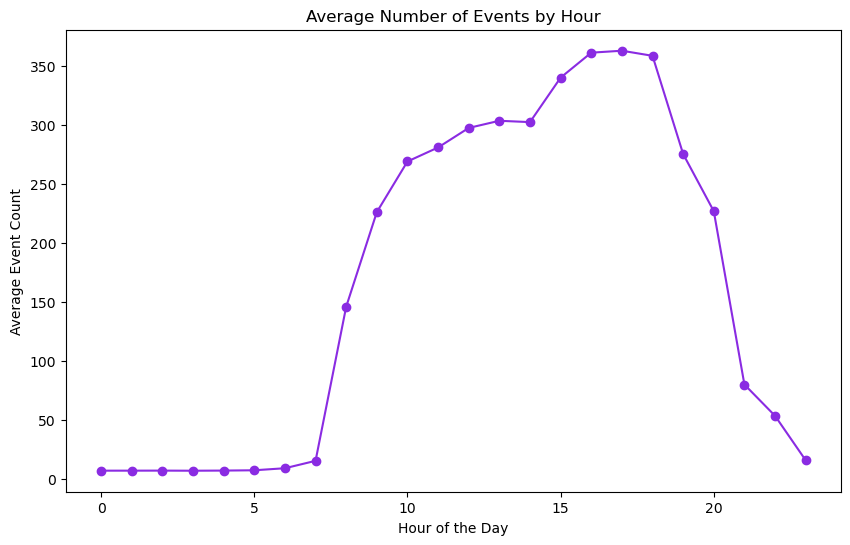

In [27]:
# Aggregating the total event counts by hour using the average
aggregated_data = hourly_event_count.groupby('hour')['total_event_count'].mean()

# Plotting the line graph
plt.figure(figsize=(10, 6))
plt.plot(aggregated_data.index, aggregated_data.values, marker='o', linestyle='-', color='blueviolet')

# Adding title and labels
plt.title('Average Number of Events by Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Event Count')

# Display the plot
plt.show()

### Plot the average number of pickups per hour

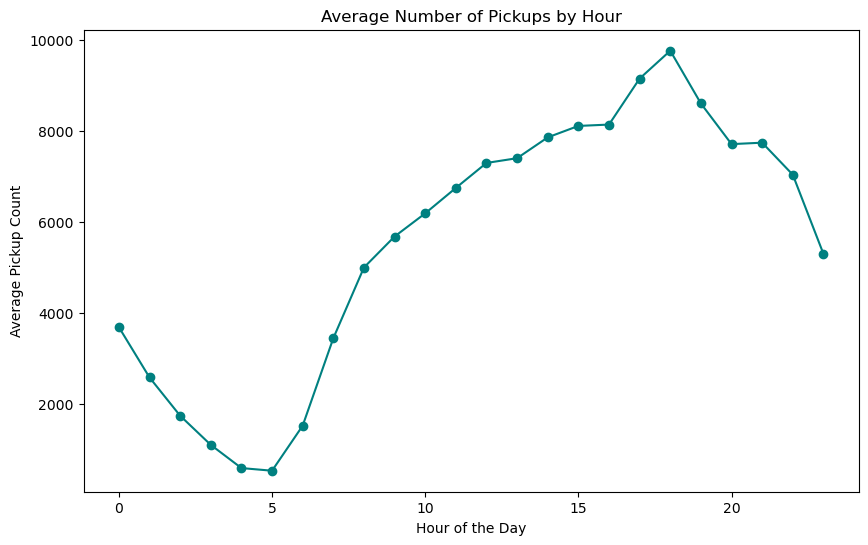

In [28]:
# Aggregating the average pickup count by hour
average_pickups_by_hour = hourly_pu_do_counts.groupby('hour')['total_pickup_count'].mean()

# Plotting the line graph for average number of pickups by hour
plt.figure(figsize=(10, 6))
plt.plot(average_pickups_by_hour.index, average_pickups_by_hour.values, marker='o', linestyle='-', color='teal')

# Adding title and labels
plt.title('Average Number of Pickups by Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Pickup Count')

# Display the plot
plt.show()

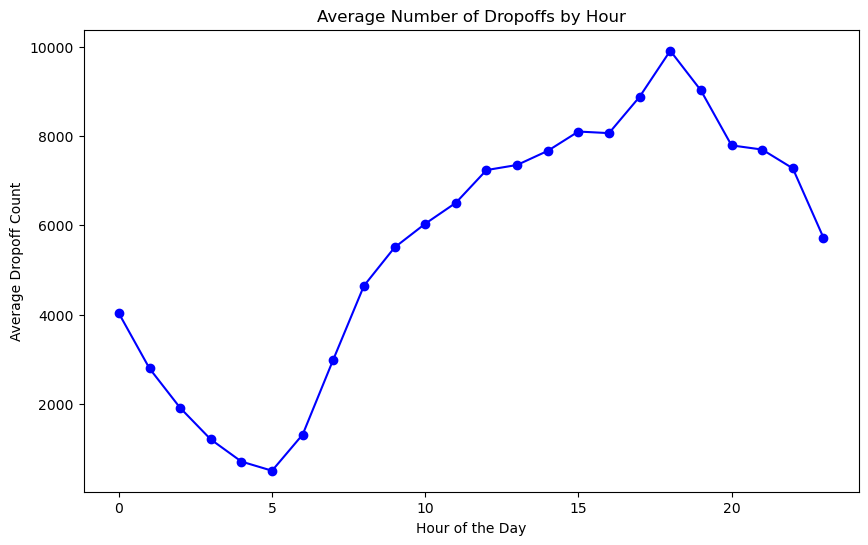

In [29]:
# Aggregating the average pickup count by hour
average_pickups_by_hour = hourly_pu_do_counts.groupby('hour')['total_dropoff_count'].mean()

# Plotting the line graph for average number of pickups by hour
plt.figure(figsize=(10, 6))
plt.plot(average_pickups_by_hour.index, average_pickups_by_hour.values, marker='o', linestyle='-', color='blue')

# Adding title and labels
plt.title('Average Number of Dropoffs by Hour')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Dropoff Count')

# Display the plot
plt.show()

## Combining the previous two plots to be displayed on one
One thing to make sure here is to have two different y-axes to align the plots

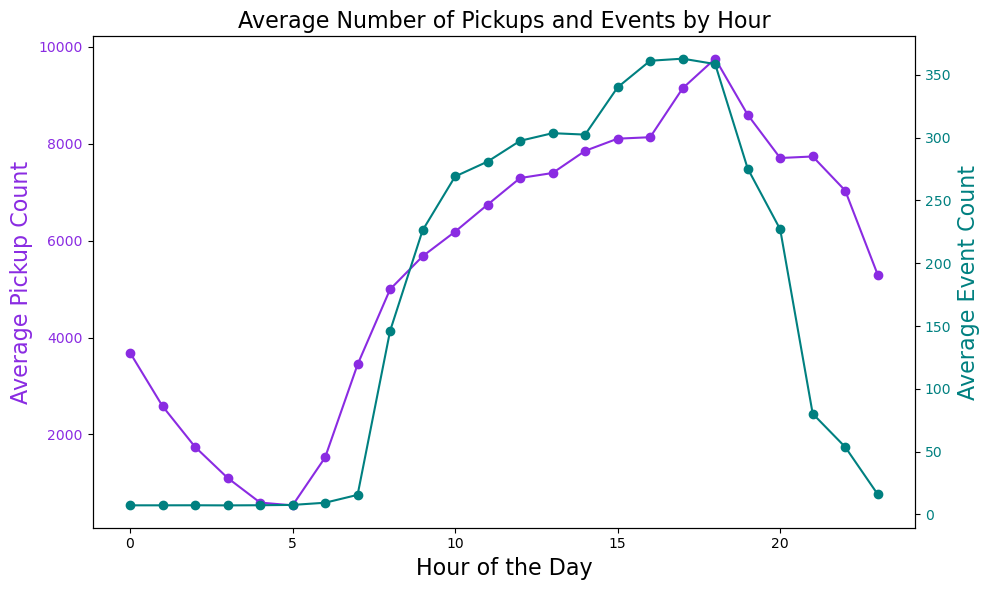

In [30]:
# Aggregating the average pickup counts and event counts by hour
average_pickups_by_hour = hourly_pu_do_counts.groupby('hour')['total_pickup_count'].mean()
average_events_by_hour = hourly_event_count.groupby('hour')['total_event_count'].mean()

# Plotting the line graph with two y-axes
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting the first line (Average Pickups) on the first y-axis
ax1.plot(average_pickups_by_hour.index, average_pickups_by_hour.values, marker='o', linestyle='-', color='blueviolet', label='Average Pickups')
ax1.set_xlabel('Hour of the Day', fontsize=16)
ax1.set_ylabel('Average Pickup Count', color='blueviolet', fontsize=16)
ax1.tick_params(axis='y', labelcolor='blueviolet')

# Creating the second y-axis
ax2 = ax1.twinx()
ax2.plot(average_events_by_hour.index, average_events_by_hour.values, marker='o', linestyle='-', color='teal', label='Average Events')
ax2.set_ylabel('Average Event Count', color='teal', fontsize=16)
ax2.tick_params(axis='y', labelcolor='teal')

# Adding title and a legend
plt.title('Average Number of Pickups and Events by Hour', fontsize=16)
fig.tight_layout()

# Save the plot as a PNG file
plt.savefig('../plots/average_events_pu_hour.png', dpi=300, bbox_inches='tight')

# Display the plot
plt.show()

In [31]:
# Read in the taxi zone to precinct mapping
mapping = pd.read_csv("../data/curated/taxi_zone_to_precinct_mapping.csv")

## Map the number of events according ot the taxi zones

In [32]:
# Now merge the events data with the mapping to get taxi zones for each event
events_with_zones = pd.merge(precinct_data, mapping, left_on='police_precinct', right_on='Precinct', how='left')

# Aggregate the number of events per taxi zone
events_per_taxi_zone = events_with_zones.groupby('LocationID').mean().reset_index()

# Create the map
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map for events by taxi zones
c = folium.Choropleth(
    geo_data=geoJSON_taxizone,  # geoJSON file for taxi zones
    name='choropleth',
    data=events_per_taxi_zone,  # aggregated data
    columns=['LocationID', 'total_event_count'],  # columns to use for the choropleth
    key_on='properties.LocationID',  # key in geoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Total Number of Events per Taxi Zone'
)

c.add_to(m)

# Display the map
m

In [33]:
m.save('../plots/EventsPerZoneMap.html')

In [34]:
events_per_taxi_zone

,LocationID,police_precinct,total_event_count,Precinct
0,2,100.0,976.0,100.0
1,3,49.0,1238.0,49.0
2,4,9.0,4328.0,9.0
3,5,123.0,4152.0,123.0
4,6,122.0,6214.0,122.0
...,...,...,...,...
254,259,47.0,2188.0,47.0
255,260,108.0,2136.0,108.0
256,261,1.0,1148.0,1.0
257,262,19.0,1846.0,19.0


## Map the number of taxi pickups according to the police precinct

In [35]:
# Assuming your taxi data is in a DataFrame called `pu_do_counts`
# Merge the taxi data with the mapping to get precincts for each taxi zone
taxi_data_with_precincts = pd.merge(pu_do_counts, mapping, left_on='location_id', right_on='LocationID', how='left')

# Aggregate the number of pickups by police precinct
taxi_data_per_precinct = taxi_data_with_precincts.groupby('Precinct').sum().reset_index()

# Create the map
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map for taxi pickups by precincts
c = folium.Choropleth(
    geo_data=geoJSON_precincts,  # geoJSON file for precincts
    name='choropleth',
    data=taxi_data_per_precinct,  # aggregated data
    columns=['Precinct', 'total_pickup_count'],  # columns to use for the choropleth
    key_on='properties.Precinct',  # key in geoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Total Number of Pickups per Precinct'
)

c.add_to(m)

# Display the map
m


In [36]:
m.save('../plots/PUPerPrecinctMap.html')

## Calculate the average number of events, pickups, and dropoffs based on precinct and taxi zone respectively

In [37]:
# Load the datasets
hourly_events_df = pd.read_csv('../data/curated/events/hourly_event_per_precinct.csv')
hourly_pu_do_counts_df = pd.read_csv('../data/curated/taxi/hourly_pu_do_counts_location.csv')

# Convert the 'date' to a datetime object if not already
hourly_pu_do_counts_df['date'] = pd.to_datetime(hourly_pu_do_counts_df['date'])

# Group by date and location_id to calculate daily total pickups
daily_pickups_per_zone = hourly_pu_do_counts_df.groupby(['date', 'location_id'])['pickup_trip_count'].sum().reset_index()

# Group by date and location_id to calculate daily total pickups
daily_dropoffs_per_zone = hourly_pu_do_counts_df.groupby(['date', 'location_id'])['dropoff_trip_count'].sum().reset_index()

# Calculate the average number of pickups per day per taxi zone
avg_pickups_per_zone = daily_pickups_per_zone.groupby('location_id')['pickup_trip_count'].mean().reset_index()
avg_pickups_per_zone.rename(columns={'pickup_trip_count': 'avg_pickups_per_day'}, inplace=True)

# Calculate the average number of dropoffs per day per taxi zone
avg_dropoffs_per_zone = daily_dropoffs_per_zone.groupby('location_id')['dropoff_trip_count'].mean().reset_index()
avg_dropoffs_per_zone.rename(columns={'dropoff_trip_count': 'avg_dropoffs_per_day'}, inplace=True)

# Convert the 'event_date' to a datetime object if not already
hourly_events_df['event_date'] = pd.to_datetime(hourly_events_df['event_date'])

# Group by date and police precinct to calculate daily total events
daily_events_per_precinct = hourly_events_df.groupby(['event_date', 'police_precinct'])['total_event_count'].sum().reset_index()

# Calculate the average number of events per day per precinct
avg_events_per_precinct = daily_events_per_precinct.groupby('police_precinct')['total_event_count'].mean().reset_index()
avg_events_per_precinct.rename(columns={'total_event_count': 'avg_events_per_day'}, inplace=True)


## Map average number of pickups per day (taxi zones)

In [38]:
# Create the map
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map for average pickups per day by taxi zones
c = folium.Choropleth(
    geo_data=geoJSON_taxizone,  # GeoJSON file for taxi zones
    name='choropleth',
    data=avg_pickups_per_zone,  # aggregated data
    columns=['location_id', 'avg_pickups_per_day'],  # columns to use for the choropleth
    key_on='properties.LocationID',  # key in GeoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Average Number of Pickups Per Day'
)

c.add_to(m)

# Display the map
m

In [39]:
m.save('../plots/AvgDailyPUperZone.html')

## Map log of average number of pickups per day (taxi zones)

In [40]:
# Apply log transformation to the average pickups per day
avg_pickups_per_zone['log_avg_pickups_per_day'] = np.log1p(avg_pickups_per_zone['avg_pickups_per_day'])

# Create the map centered around NYC
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map using the log of average pickups per day by taxi zones
c = folium.Choropleth(
    geo_data=geoJSON_taxizone,  # GeoJSON file for taxi zones
    name='choropleth',
    data=avg_pickups_per_zone,  # transformed data
    columns=['location_id', 'log_avg_pickups_per_day'],  # columns to use for the choropleth
    key_on='properties.LocationID',  # key in GeoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Log of Average Number of Pickups Per Day',
    font_size=20
)

c.add_to(m)

# Display the map
m

In [41]:
m.save('../plots/LogAvgPUDailyperZone.html')

## Map the log of average number of dropoffs per day (taxi zones)

In [42]:
# Apply log transformation to the average pickups per day
avg_dropoffs_per_zone['log_avg_dropoffs_per_day'] = np.log1p(avg_dropoffs_per_zone['avg_dropoffs_per_day'])

# Create the map centered around NYC
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map using the log of average pickups per day by taxi zones
c = folium.Choropleth(
    geo_data=geoJSON_taxizone,  # GeoJSON file for taxi zones
    name='choropleth',
    data=avg_dropoffs_per_zone,  # transformed data
    columns=['location_id', 'log_avg_dropoffs_per_day'],  # columns to use for the choropleth
    key_on='properties.LocationID',  # key in GeoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Log of Average Number of Dropoffs Per Day',
    font_size=20
)

c.add_to(m)

# Display the map
m

In [43]:
m.save('../plots/LogAvgDODailyperZone.html')

## Map average number of events per day (taxi zones)

In [44]:
# Merge the precinct-based event data with the mapping to get taxi zones
avg_events_per_zone = pd.merge(avg_events_per_precinct, mapping, left_on='police_precinct', right_on='Precinct', how='left')

# Now group by the taxi zone and take the mean, if there are multiple precincts per zone
avg_events_per_zone = avg_events_per_zone.groupby('LocationID')['avg_events_per_day'].mean().reset_index()

# Create the map centered around NYC
m = folium.Map(location=[40.73, -73.74], tiles="Stamen Terrain", zoom_start=10)

# Create the Choropleth map for average events per day by taxi zones
c = folium.Choropleth(
    geo_data=geoJSON_taxizone,  # GeoJSON file for taxi zones
    name='choropleth',
    data=avg_events_per_zone,  # aggregated data
    columns=['LocationID', 'avg_events_per_day'],  # columns to use for the choropleth
    key_on='properties.LocationID',  # key in GeoJSON to link data
    fill_color='YlGnBu',  # color scheme
    nan_fill_color='black',
    legend_name='Average Number of Events Per Day'
)

c.add_to(m)

# Display the map
m

In [45]:
m.save('../plots/AvgDailyEventsperZone.html')

## Look into events relation with weather

In [46]:
# Read in the cleaned weather data
weather_df = pd.read_csv("../data/curated/weather/weather_cleaned.csv")

In [47]:
weather_df.head()

,date,precip,snowfall,max_temp,min_temp,avg_wind_sp,avg_rel_humi,fog,heavy_fog,thunder,avg_temp
0,2023-01-01,0,0.0,128.0,94.0,22.0,64.0,1.0,0.0,0.0,111.0
1,2023-01-02,5,0.0,133.0,94.0,16.0,65.0,0.0,0.0,0.0,113.5
2,2023-01-03,107,0.0,144.0,83.0,14.0,89.0,1.0,0.0,0.0,113.5
3,2023-01-04,5,0.0,189.0,94.0,20.0,80.0,1.0,0.0,0.0,141.5
4,2023-01-05,3,0.0,100.0,67.0,23.0,90.0,1.0,0.0,0.0,83.5


In [48]:
# Convert temperature values from tenths of degrees Celsius to degrees Celsius
weather_df['max_temp'] = weather_df['max_temp'] / 10
weather_df['min_temp'] = weather_df['min_temp'] / 10
weather_df['avg_temp'] = weather_df['avg_temp'] / 10
# # Calculate the average temperature
# weather_df['avg_temp'] = (weather_df['max_temp'] + weather_df['min_temp']) / 2


In [49]:
weather_df.head()

,date,precip,snowfall,max_temp,min_temp,avg_wind_sp,avg_rel_humi,fog,heavy_fog,thunder,avg_temp
0,2023-01-01,0,0.0,12.8,9.4,22.0,64.0,1.0,0.0,0.0,11.10
1,2023-01-02,5,0.0,13.3,9.4,16.0,65.0,0.0,0.0,0.0,11.35
2,2023-01-03,107,0.0,14.4,8.3,14.0,89.0,1.0,0.0,0.0,11.35
3,2023-01-04,5,0.0,18.9,9.4,20.0,80.0,1.0,0.0,0.0,14.15
4,2023-01-05,3,0.0,10.0,6.7,23.0,90.0,1.0,0.0,0.0,8.35


In [50]:
daily_event = pd.read_csv("../data/curated/events/daily_event_count.csv")

In [51]:
daily_event.head()

,event_date,total_event_count
0,2023-01-01,222
1,2023-01-02,127
2,2023-01-03,128
3,2023-01-04,125
4,2023-01-05,129


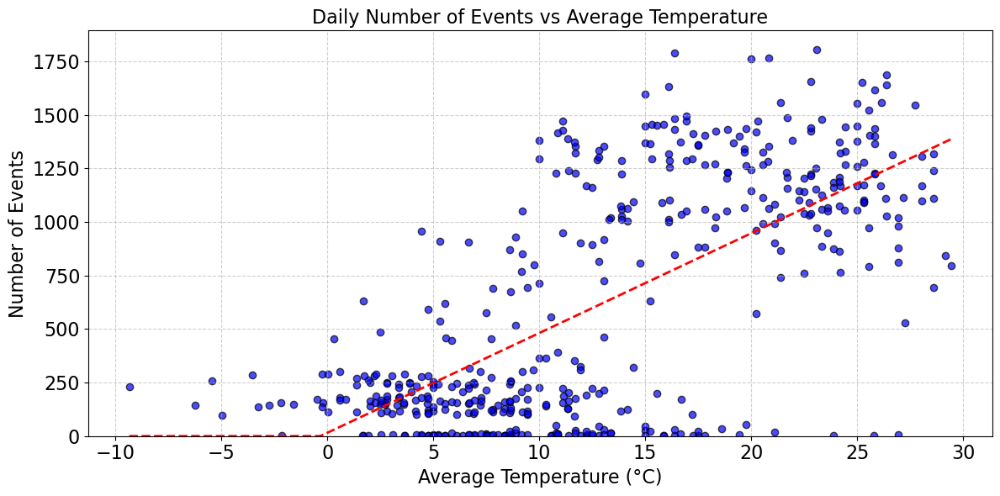

In [52]:
# Merge daily_event with weather_df to get daily event count and average temperature
daily_event_weather_df = pd.merge(daily_event, weather_df, left_on='event_date', right_on='date')

# Scatter plot
plt.figure(figsize=(12, 6))
plt.scatter(daily_event_weather_df['avg_temp'], daily_event_weather_df['total_event_count'], color='blue', alpha=0.7, edgecolors='k')

# Calculate the line of best fit
z = np.polyfit(daily_event_weather_df['avg_temp'], daily_event_weather_df['total_event_count'], 1)
p = np.poly1d(z)

# Plot the line of best fit
x_vals = np.linspace(min(daily_event_weather_df['avg_temp']), max(daily_event_weather_df['avg_temp']), 100)
y_vals = np.maximum(p(x_vals), 0)
plt.plot(x_vals, y_vals, color='red', linewidth=2, linestyle='--')

# Add titles and labels with enhanced formatting
plt.title('Daily Number of Events vs Average Temperature', fontsize=16)
plt.xlabel('Average Temperature (°C)', fontsize=16)
plt.ylabel('Number of Events', fontsize=16)
plt.grid(True, linestyle='--', alpha=0.6)

# Set y-axis to start at 0
plt.ylim(bottom=0)

plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.tight_layout()

# Save the plot as a PNG file
plt.savefig('../plots/average_temp_events.png', dpi=300, bbox_inches='tight')

plt.show()

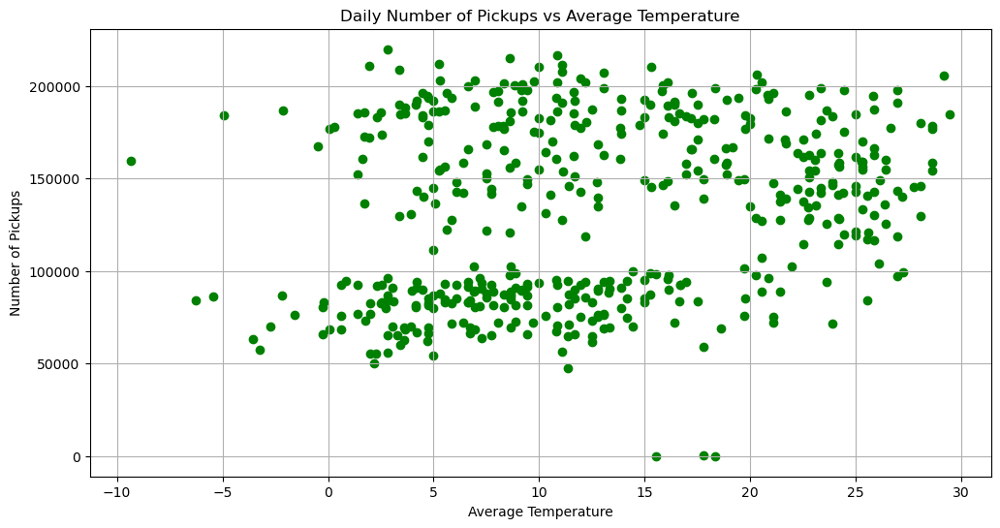

In [53]:
# Merge hourly_pu_do_counts with weather_df to get daily pickup count and average temperature
daily_pickup_weather_df = hourly_pu_do_counts.groupby('date').agg({
    'total_pickup_count': 'sum'
}).reset_index()

# Merge with weather data on date
daily_pickup_weather_df = pd.merge(daily_pickup_weather_df, weather_df, on='date')

# Plotting
plt.figure(figsize=(12, 6))
plt.scatter(daily_pickup_weather_df['avg_temp'], daily_pickup_weather_df['total_pickup_count'], color='green')
plt.title('Daily Number of Pickups vs Average Temperature')
plt.xlabel('Average Temperature')
plt.ylabel('Number of Pickups')
plt.grid(True)
plt.show()